In [1]:
%load_ext autoreload
%autoreload 2

In [1]:
# !pip install skfolio

In [2]:
import sovai as sov

sov.token_auth(token="your_token_here")

### Data Preparation
Let's prepare our dataset for weight optimization

In [3]:
import pandas as pd

df_price = sov.data("market/closeadj")
df_mega = df_price.select_stocks("mega").date_range("2000-01-01")

From long to wide format

In [4]:
df_returns = df_mega.calculate_returns().dropna(axis=1,how="any")

There are more than 50 mega companies with long histories

In [5]:
df_returns.head(3)

ticker,AAPL,ABT,ADBE,AIG,AMD,AMZN,ASML,AZN,BA,BAC,BHP,BP,BRK.B,C,CMCSA,COST,CSCO,CVX,DHR,DIS,GE,HD,HSBC,IBM,INTC,JNJ,JPM,KO,LLY,MCD,MRK,MSFT,NKE,NVDA,NVO,NVS,ORCL,PEP,PFE,PG,QCOM,SAP,T,TM,TMO,TSM,TTE,UNH,VZ,WFC,WMT,XOM
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2000-01-04,-0.084,-0.029,-0.084,-0.051,-0.056,-0.083,-0.067,-0.033,-0.001,-0.059,0.036,-0.005,-0.035,-0.061,-0.075,-0.055,-0.056,0.000,-0.036,0.059,-0.040,-0.103,-0.061,-0.034,-0.047,-0.037,-0.022,0.003,-0.031,-0.021,-0.035,-0.034,-0.054,-0.022,-0.004,-0.019,-0.088,-0.025,-0.037,-0.020,-0.096,-0.089,-0.059,-0.046,-0.037,0.007,-0.029,-0.013,-0.032,-0.049,-0.037,-0.019
2000-01-05,0.014,-0.006,0.018,0.005,0.002,-0.124,-0.034,0.000,0.070,0.011,0.005,0.034,0.016,0.040,-0.028,0.017,0.008,0.022,0.028,0.035,-0.002,0.056,-0.006,0.035,0.020,0.016,-0.006,0.011,0.015,0.021,0.046,0.011,0.058,-0.034,-0.020,0.004,-0.039,-0.014,0.018,-0.009,-0.025,-0.036,0.011,0.004,-0.004,0.006,0.000,-0.002,0.033,-0.003,-0.023,0.050
2000-01-06,-0.087,0.039,0.010,0.028,0.092,-0.086,-0.055,0.002,0.003,0.086,-0.009,0.002,0.042,0.048,0.040,0.020,-0.027,0.039,-0.005,-0.034,0.013,-0.028,-0.028,-0.017,-0.069,0.026,0.014,-0.001,0.027,-0.019,0.002,-0.033,-0.005,-0.060,0.017,0.022,-0.072,0.034,0.034,0.035,-0.113,-0.004,-0.017,-0.089,0.013,-0.042,-0.022,0.037,-0.005,0.037,0.014,0.057


I only want to select 25 companies that are the most uncorrelated.

In [6]:
feature_importance = df_returns.importance()

In [7]:
feature_importance.head(5)

,feature,importance,importance_percentile
0,AIG,1.385,100.000
1,VZ,1.377,98.077
2,BHP,1.356,96.154
3,HD,1.296,94.231
4,HSBC,1.287,92.308


In [8]:
df_select = df_returns[feature_importance["feature"].head(25)]

### Weight Optimization

In [139]:
df_select.tail(2)

ticker,AIG,VZ,BHP,HD,HSBC,UNH,MSFT,JPM,ADBE,PEP,NVDA,NVO,BP,IBM,TM,C,NVS,BAC,TMO,ASML,CVX,WMT,AMZN,ABT,SAP
date,,,,,,,,,,,,,,,,,,,,,,,,,
2024-07-18,-0.007,0.001,-0.015,-0.016,-0.011,-0.016,-0.007,-0.032,-0.011,0.003,0.026,-0.040,0.005,-0.012,-0.022,-0.040,-0.041,-0.022,-0.026,-0.008,0.005,-0.003,-0.022,-0.044,-0.014
2024-07-19,-0.047,-0.011,-0.008,-0.007,-0.004,0.002,-0.007,-0.001,-0.011,-0.006,-0.026,0.012,-0.006,-0.011,-0.014,0.004,-0.010,-0.003,-0.012,-0.031,-0.017,-0.001,-0.003,0.020,-0.000


In [321]:
from plotly.io import show
from sklearn.model_selection import GridSearchCV, train_test_split

from skfolio import Population, RatioMeasure, RiskMeasure
from skfolio.cluster import HierarchicalClustering, LinkageMethod
from skfolio.datasets import load_ftse100_dataset
from skfolio.distance import KendallDistance, PearsonDistance
from skfolio.metrics import make_scorer
from skfolio.model_selection import (
    CombinatorialPurgedCV,
    WalkForward,
    cross_val_predict,
    optimal_folds_number,
)
from skfolio.optimization import (
    HierarchicalEqualRiskContribution,
    HierarchicalRiskParity,
)
from skfolio.preprocessing import prices_to_returns

from skfolio.moments import (
    DenoiseCovariance,
    DetoneCovariance,
    EWMu,
    GerberCovariance,
    ShrunkMu,
)


cv = WalkForward(train_size=252, test_size=90)

model_hrp = HierarchicalRiskParity(
    risk_measure=RiskMeasure.CVAR,
    hierarchical_clustering_estimator=HierarchicalClustering(),
)

model_herc = HierarchicalEqualRiskContribution(
    risk_measure=RiskMeasure.CVAR,
    hierarchical_clustering_estimator=HierarchicalClustering(),
)

model_nco = NestedClustersOptimization(
    inner_estimator=MeanRisk(), clustering_estimator=HierarchicalClustering()
)



grid_search_hrp = GridSearchCV(
    estimator=model_hrp,
    cv=cv,
    n_jobs=-1,
    param_grid={
        "distance_estimator": [PearsonDistance(), KendallDistance()],
        "hierarchical_clustering_estimator__linkage_method": [
            LinkageMethod.WARD,
            LinkageMethod.COMPLETE,
        ],
    },
    scoring=make_scorer(RatioMeasure.CVAR_RATIO),
)
grid_search_hrp.fit(df_select)
model_hrp = grid_search_hrp.best_estimator_
print(model_hrp)

grid_search_herc = grid_search_hrp.set_params(estimator=model_herc)
grid_search_herc.fit(df_select)
model_herc = grid_search_herc.best_estimator_
print(model_herc)

from skfolio.optimization import (
    EqualWeighted,
    MeanRisk,
    NestedClustersOptimization,
    ObjectiveFunction,
    RiskBudgeting,
)

inner_estimator = MeanRisk(
    objective_function=ObjectiveFunction.MAXIMIZE_RATIO,
    risk_measure=RiskMeasure.VARIANCE,
)
outer_estimator = RiskBudgeting(risk_measure=RiskMeasure.CVAR)

grid_search_nco = GridSearchCV(
    estimator=model_nco,
    cv=cv,
    n_jobs=-1,
    param_grid={
        "inner_estimator__risk_measure": [RiskMeasure.VARIANCE, RiskMeasure.CVAR],
        "outer_estimator": [
            EqualWeighted(),
            RiskBudgeting(risk_measure=RiskMeasure.CVAR),
        ],
        "clustering_estimator__linkage_method": [
            LinkageMethod.SINGLE,
            LinkageMethod.WARD,
        ],
        "distance_estimator": [PearsonDistance(), KendallDistance()],
    },
)
grid_search_nco.fit(df_select)
model_nco = grid_search_nco.best_estimator_
print(model_nco)

from skfolio.optimization import EqualWeighted, HierarchicalRiskParity


cv = WalkForward(train_size=252, test_size=90)


bench = EqualWeighted()

pred_hrp = cross_val_predict(
    model_hrp,
    df_select,
    cv=cv,
    n_jobs=-1,
    portfolio_params=dict(name="HRP", tag="HRP"),
)

pred_herc = cross_val_predict(
    model_herc,
    df_select,
    cv=cv,
    n_jobs=-1,
    portfolio_params=dict(name="HERC"),
)

pred_nco = cross_val_predict(
    model_nco,
    df_select,
    cv=cv,
    n_jobs=-1,
    portfolio_params=dict(name="NCO"),
)

pred_bench = cross_val_predict(
    bench,
    df_select,
    cv=cv,
    n_jobs=-1,
    portfolio_params=dict(name="EQUAL"),
)



summary_dict = {"HRP":pred_hrp, "HERC":pred_herc, "NCO":pred_nco, "EQUAL":pred_bench}


summary_dict_model = {"HRP":model_hrp, "HERC":model_herc, "NCO":model_nco, "EQUAL":bench}


population =  Population([pred_hrp, pred_herc, pred_nco, pred_bench ]) 

# portfolio =  df_select.weight_optimization()

HierarchicalRiskParity(distance_estimator=PearsonDistance(),
                       hierarchical_clustering_estimator=HierarchicalClustering(),
                       risk_measure=CVaR)
HierarchicalEqualRiskContribution(distance_estimator=PearsonDistance(),
                                  hierarchical_clustering_estimator=HierarchicalClustering(linkage_method=COMPLETE),
                                  risk_measure=CVaR)
NestedClustersOptimization(clustering_estimator=HierarchicalClustering(linkage_method=SINGLE),
                           distance_estimator=KendallDistance(),
                           inner_estimator=MeanRisk(risk_measure=CVaR),
                           outer_estimator=EqualWeighted())


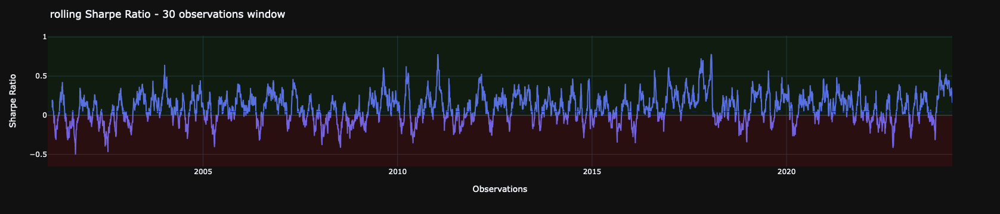

In [291]:
population.set_portfolio_params(compounded=False)

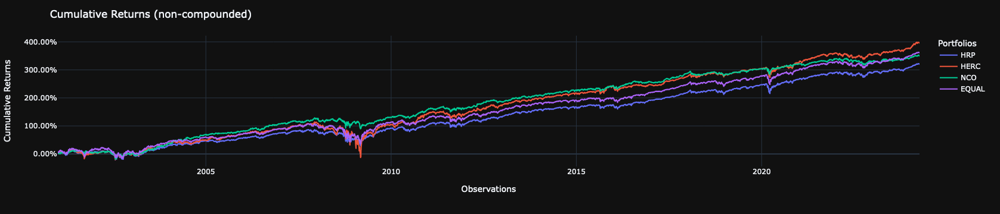

In [292]:
fig = population.plot_cumulative_returns()
show(fig)

In [241]:
summary = population.summary()
summary

,HRP,HERC,NCO,EQUAL
Mean,0.055%,0.068%,0.060%,0.062%
Annualized Mean,13.83%,17.09%,15.07%,15.58%
Variance,0.014%,0.026%,0.011%,0.017%
Annualized Variance,3.46%,6.56%,2.89%,4.39%
Semi-Variance,0.0071%,0.012%,0.0057%,0.0089%
Annualized Semi-Variance,1.80%,3.03%,1.45%,2.25%
Standard Deviation,1.17%,1.61%,1.07%,1.32%
Annualized Standard Deviation,18.61%,25.62%,17.00%,20.96%
Semi-Deviation,0.84%,1.10%,0.76%,0.94%
Annualized Semi-Deviation,13.40%,17.42%,12.04%,15.00%


In [226]:
from skfolio.optimization import EqualWeighted, HierarchicalRiskParity

bench = EqualWeighted()


n_folds, n_test_folds = optimal_folds_number(
    n_observations=df_select.shape[0],
    target_n_test_paths=50,
    target_train_size=252,
)

print(n_folds)
print(n_test_folds)


cv = CombinatorialPurgedCV(n_folds=n_folds, n_test_folds=n_test_folds)


pred_hrp_comb = cross_val_predict(
    model_hrp,
    df_select,
    cv=cv,
    n_jobs=-1,
    portfolio_params=dict(tag="HRP"),
)

pred_herc_comb = cross_val_predict(
    model_herc,
    df_select,
    cv=cv,
    n_jobs=-1,
    portfolio_params=dict(tag="HERC"),
)

pred_nco_comb = cross_val_predict(
    model_nco,
    df_select,
    cv=cv,
    n_jobs=-1,
    portfolio_params=dict(tag="NCO"),
)

pred_bench_comb = cross_val_predict(
    bench,
    df_select,
    cv=cv,
    n_jobs=-1,
    portfolio_params=dict(tag="EQUAL"),
)



51
50


In [ ]:
These are the only inputs I will need. 

summary_dict = {"HRP":pred_hrp, "HERC":pred_herc, "NCO":pred_nco, "EQUAL":pred_bench}

summary_dict_model = {"HRP":model_hrp, "HERC":model_herc, "NCO":model_nco, "EQUAL":bench}

population =  Population([pred_hrp, pred_herc, pred_nco, pred_bench ]) 

summary_dict_comb = {"HRP":pred_hrp_comb, "HERC":pred_herc_comb, "NCO":pred_nco_comb, "EQUAL":pred_bench_comb}

population_combinatorial =  pred_hrp + pred_herc + pred_nco + pred_bench





In [ ]:
portfolio.best_model = summary_dict.T["Sharpe Ratio"].sort_values().index[-1]

portfolio.sharpe_plot = population_combinatorial.plot_distribution(
    measure_list=[RatioMeasure.ANNUALIZED_SHARPE_RATIO],tag_list=["HRP","HERC","NCO"], n_bins=50
)



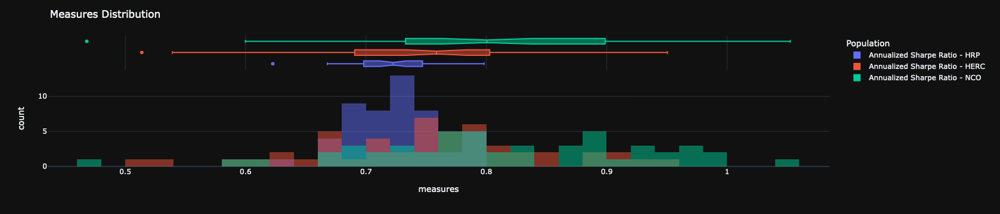

In [ ]:
portfolio["MODELNAME"].sharpe_plot = summary_dict["MODELNAME"].plot_rolling_measure(measure=RatioMeasure.SHARPE_RATIO)


In [250]:
best_model_name = summary_mods.T["Sharpe Ratio"].sort_values().index[-1]

In [253]:
best_model_comb= summary_dict_comb[best_model_name]

In [ ]:
pred_hrp.plot_rolling_measure(measure=RatioMeasure.SHARPE_RATIO)

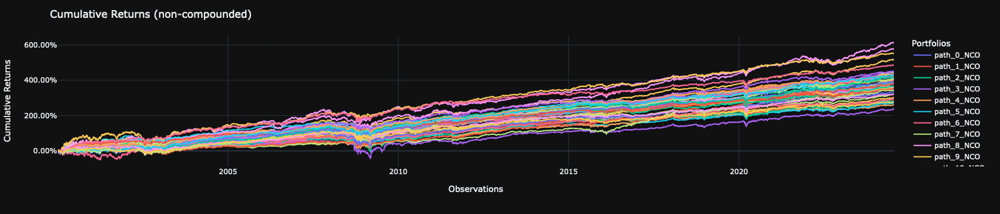

In [244]:
fig = best_model_comb.plot_cumulative_returns()
show(fig)

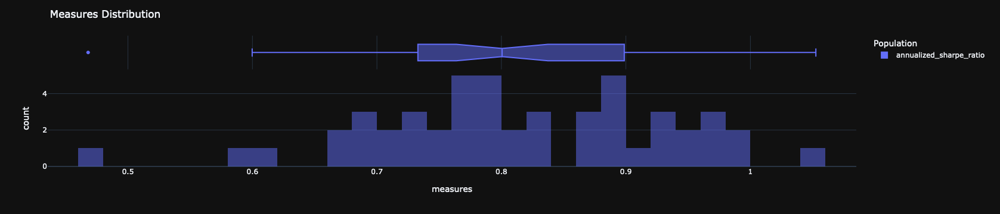

In [246]:
best_model_comb.plot_distribution(
    measure_list=[RatioMeasure.ANNUALIZED_SHARPE_RATIO], n_bins=50
)

In [245]:
best_model_comb.summary().T.sort_values("Mean",ascending=False)

,Mean,Annualized Mean,Variance,Annualized Variance,Semi-Variance,Annualized Semi-Variance,Standard Deviation,Annualized Standard Deviation,Semi-Deviation,Annualized Semi-Deviation,Mean Absolute Deviation,CVaR at 95%,EVaR at 95%,Worst Realization,CDaR at 95%,MAX Drawdown,Average Drawdown,EDaR at 95%,First Lower Partial Moment,Ulcer Index,Gini Mean Difference,Value at Risk at 95%,Drawdown at Risk at 95%,Entropic Risk Measure at 95%,Fourth Central Moment,Fourth Lower Partial Moment,Skew,Kurtosis,Sharpe Ratio,Annualized Sharpe Ratio,Sortino Ratio,Annualized Sortino Ratio,Mean Absolute Deviation Ratio,First Lower Partial Moment Ratio,Value at Risk Ratio at 95%,CVaR Ratio at 95%,Entropic Risk Measure Ratio at 95%,EVaR Ratio at 95%,Worst Realization Ratio,Drawdown at Risk Ratio at 95%,CDaR Ratio at 95%,Calmar Ratio,Average Drawdown Ratio,EDaR Ratio at 95%,Ulcer Index Ratio,Gini Mean Difference Ratio,Portfolios Number,Avg nb of Assets per Portfolio
path_38,0.099%,24.88%,0.022%,5.59%,0.011%,2.86%,1.49%,23.63%,1.06%,16.90%,1.05%,3.42%,5.97%,12.63%,43.33%,71.82%,7.22%,51.76%,0.52%,0.13,1.55%,2.18%,29.34%,2.99,0.000047%,0.000022%,-0.036,9.47,0.066,1.05,0.093,1.47,0.094,0.19,0.045,0.029,0.00033,0.017,0.0078,0.0034,0.0023,0.0014,0.014,0.0019,0.0076,0.064,51,25.0
path_18,0.093%,23.44%,0.035%,8.94%,0.017%,4.32%,1.88%,29.90%,1.31%,20.78%,1.26%,4.36%,6.28%,11.18%,51.88%,84.60%,8.91%,59.38%,0.63%,0.16,1.91%,2.84%,36.05%,2.99,0.00013%,0.000043%,0.39,10.59,0.049,0.78,0.071,1.13,0.074,0.15,0.033,0.021,0.00031,0.015,0.0083,0.0026,0.0018,0.0011,0.010,0.0016,0.0060,0.049,51,25.0
path_39,0.089%,22.45%,0.023%,5.81%,0.011%,2.82%,1.52%,24.11%,1.06%,16.79%,1.03%,3.49%,5.47%,10.56%,39.60%,78.75%,6.15%,52.63%,0.51%,0.11,1.55%,2.26%,23.20%,2.99,0.000053%,0.000020%,0.30,9.96,0.059,0.93,0.084,1.34,0.087,0.17,0.039,0.026,0.00030,0.016,0.0084,0.0038,0.0022,0.0011,0.014,0.0017,0.0078,0.058,51,25.0
path_19,0.083%,20.98%,0.019%,4.91%,0.0097%,2.45%,1.40%,22.15%,0.99%,15.66%,0.97%,3.18%,5.27%,10.47%,34.35%,60.31%,6.05%,40.78%,0.49%,0.10,1.45%,2.13%,23.85%,2.99,0.000035%,0.000015%,0.14,9.26,0.060,0.95,0.084,1.34,0.086,0.17,0.039,0.026,0.00028,0.016,0.0080,0.0035,0.0024,0.0014,0.014,0.0020,0.0080,0.057,51,25.0
path_46,0.078%,19.73%,0.016%,4.07%,0.0084%,2.11%,1.27%,20.18%,0.91%,14.52%,0.88%,2.93%,5.29%,9.87%,23.13%,53.12%,4.20%,32.05%,0.44%,0.071,1.30%,1.84%,14.68%,3.00,0.000035%,0.000015%,-0.0052,13.37,0.062,0.98,0.086,1.36,0.089,0.18,0.043,0.027,0.00026,0.015,0.0079,0.0053,0.0034,0.0015,0.019,0.0024,0.011,0.060,51,25.0
path_33,0.073%,18.36%,0.014%,3.43%,0.0069%,1.74%,1.17%,18.52%,0.83%,13.18%,0.81%,2.67%,4.83%,10.13%,21.03%,41.48%,4.05%,26.38%,0.40%,0.067,1.20%,1.68%,15.10%,3.00,0.000025%,0.000009%,0.19,13.56,0.062,0.99,0.088,1.39,0.090,0.18,0.043,0.027,0.00024,0.015,0.0072,0.0048,0.0035,0.0018,0.018,0.0028,0.011,0.061,51,25.0
path_43,0.072%,18.24%,0.017%,4.22%,0.0086%,2.16%,1.29%,20.53%,0.93%,14.71%,0.90%,2.99%,4.95%,8.84%,26.60%,49.96%,5.65%,32.89%,0.45%,0.088,1.33%,1.89%,19.37%,3.00,0.000034%,0.000014%,0.034,12.25,0.056,0.89,0.078,1.24,0.080,0.16,0.038,0.024,0.00024,0.015,0.0082,0.0037,0.0027,0.0014,0.013,0.0022,0.0082,0.054,51,25.0
path_27,0.072%,18.10%,0.022%,5.43%,0.011%,2.69%,1.47%,23.29%,1.03%,16.40%,0.98%,3.33%,7.02%,15.42%,65.44%,112.10%,9.99%,79.44%,0.49%,0.19,1.47%,2.08%,41.45%,3.00,0.000070%,0.000031%,0.16,15.02,0.049,0.78,0.070,1.10,0.074,0.15,0.034,0.022,0.00024,0.010,0.0047,0.0017,0.0011,0.00064,0.0072,0.00090,0.0038,0.049,51,25.0
path_26,0.071%,17.98%,0.022%,5.50%,0.011%,2.66%,1.48%,23.46%,1.03%,16.32%,1.00%,3.34%,6.04%,12.62%,29.40%,46.32%,6.28%,34.18%,0.50%,0.098,1.50%,2.13%,22.03%,3.00,0.000053%,0.000021%,0.30,11.13,0.048,0.77,0.069,1.10,0.072,0.14,0.034,0.021,0.00024,0.012,0.0057,0.0032,0.0024,0.0015,0.011,0.0021,0.0073,0.048,51,25.0
path_23,0.070%,17.70%,0.013%,3.19%,0.0065%,1.63%,1.12%,17.86%,0.81%,12.78%,0.78%,2.54%,5.80%,12.97%,20.60%,36.97%,4.15%,25.05%,0.39%,0.068,1.15%,1.62%,15.98%,3.00,0.000026%,0.000012%,-0.023,15.95,0.062,0.99,0.087,1.38,

In [268]:
best_model = summary_dict[best_model_name]

In [269]:
pop_pred_best= Population([best_model])

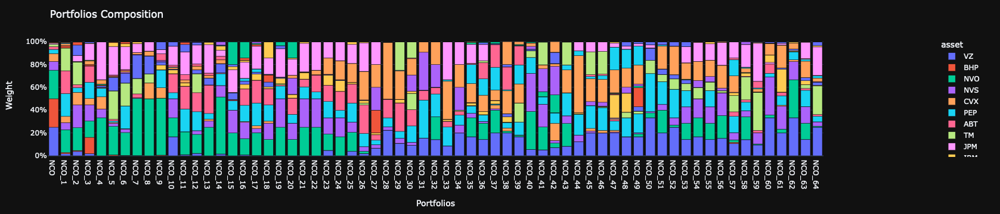

In [270]:
pop_pred_best.plot_composition(display_sub_ptf_name=False)

In [273]:
best_org_model = summary_dict_model[best_model_name]

In [295]:
population_test = Population([])
for model in [model_hrp, model_herc, model_nco, bench]:
    model.fit(df_select.tail(252))
    population_test.append(model.predict(df_select.tail(252)))

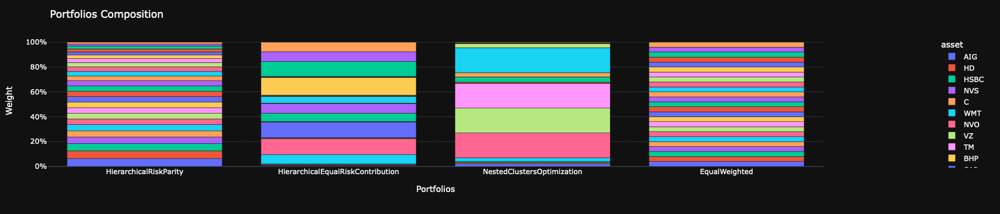

In [296]:
fig = population_test.plot_composition()
show(fig)

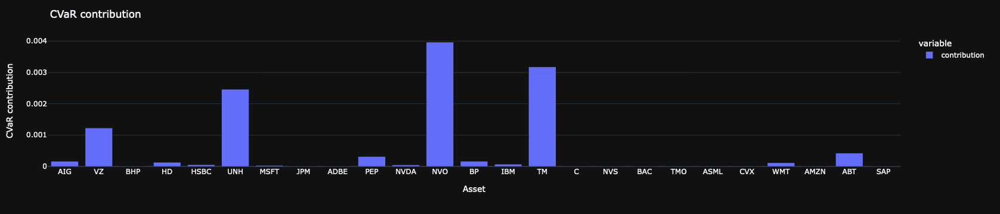

In [277]:
best_org_model.fit(df_select.tail(252))

ptf1 = best_org_model.predict(df_select.tail(252))
ptf1.plot_contribution(measure=RiskMeasure.CVAR)

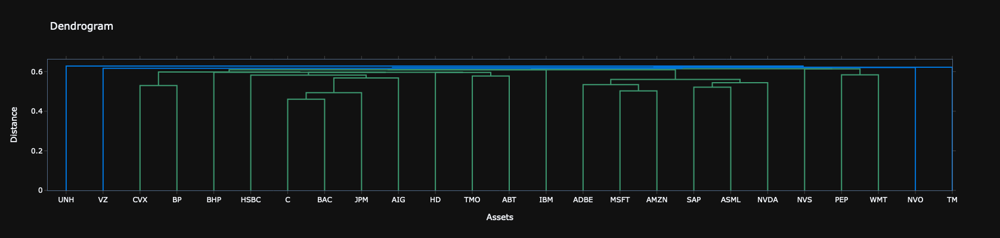

In [286]:
try:
    show(best_org_model.clustering_estimator_.plot_dendrogram(heatmap=False))
except:
    show(best_org_model.hierarchical_clustering_estimator_.plot_dendrogram(heatmap=False))
    

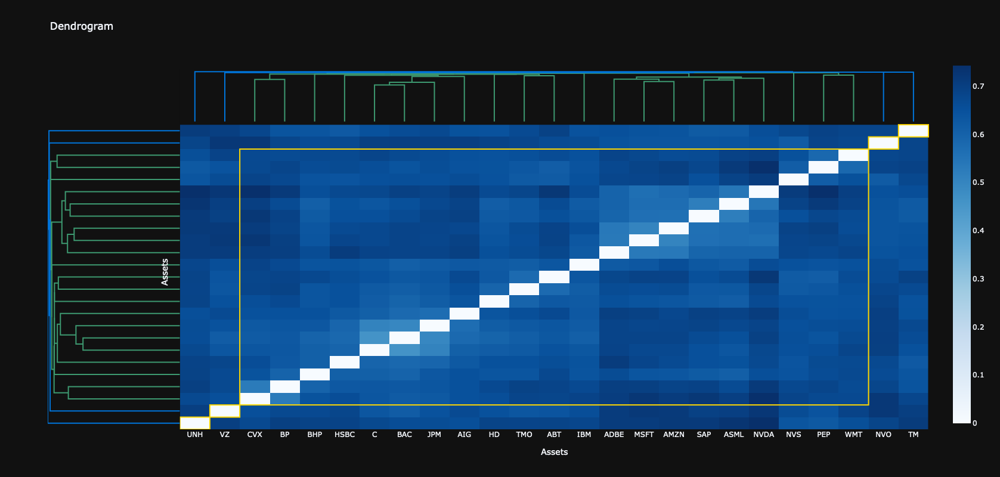

In [287]:
try:
    show(best_org_model.clustering_estimator_.plot_dendrogram(heatmap=True))
except:
    show(best_org_model.hierarchical_clustering_estimator_.plot_dendrogram(heatmap=True))
    